## Advanced Lane Finding

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

## Support Files

- `Advanced-Lane-Finding.ipynb` - The main notebook of the project.
- `helper.py` - The script contained required helper functions.
- `lineinfo.py` - The script define Python class to track line information.

In [1]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
import glob
import ntpath
import math
import os
import lineinfo
import helper

from moviepy.editor import VideoFileClip
from IPython.display import HTML

%matplotlib inline

### Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.

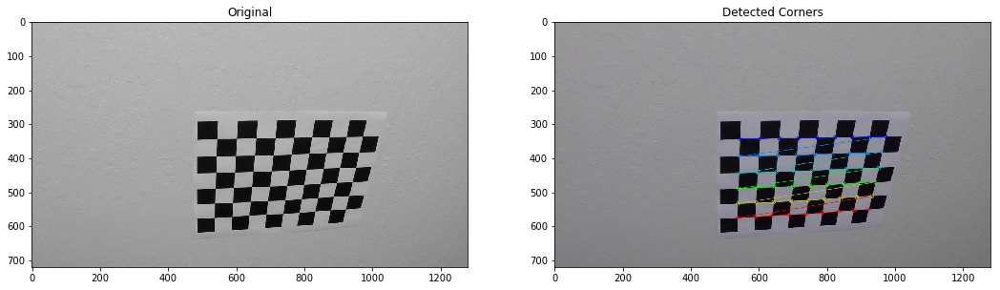

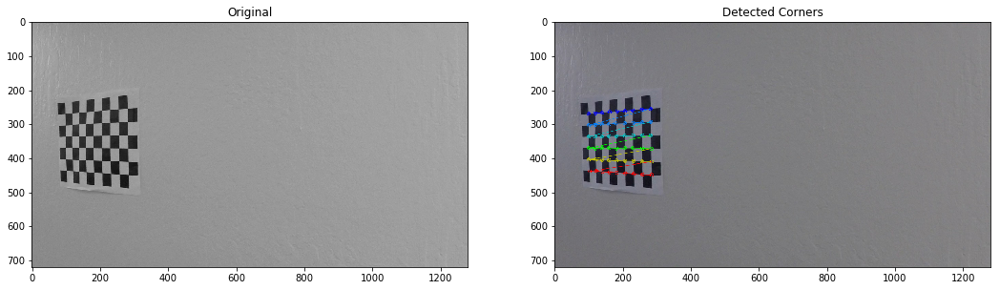

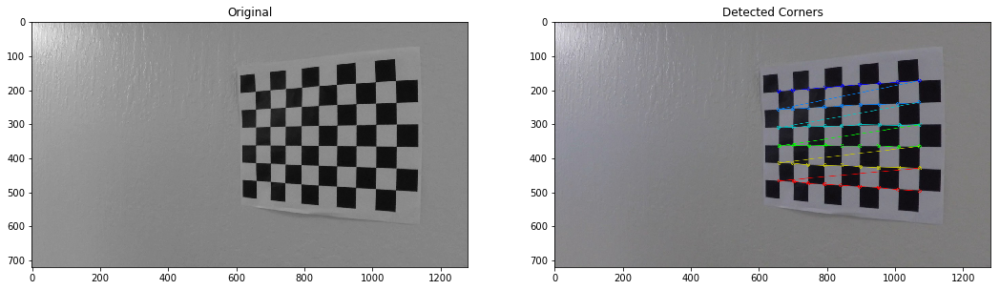

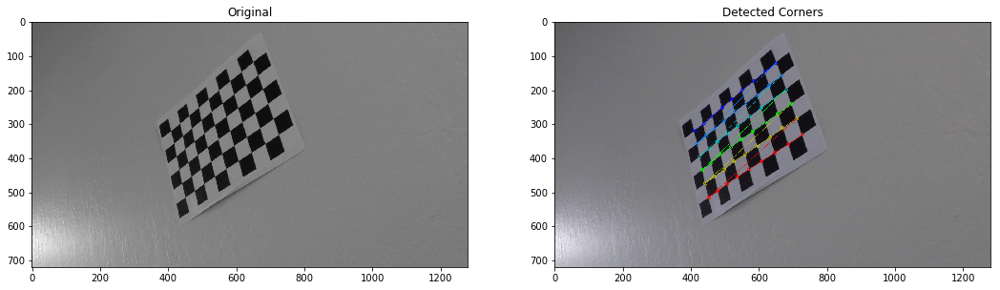

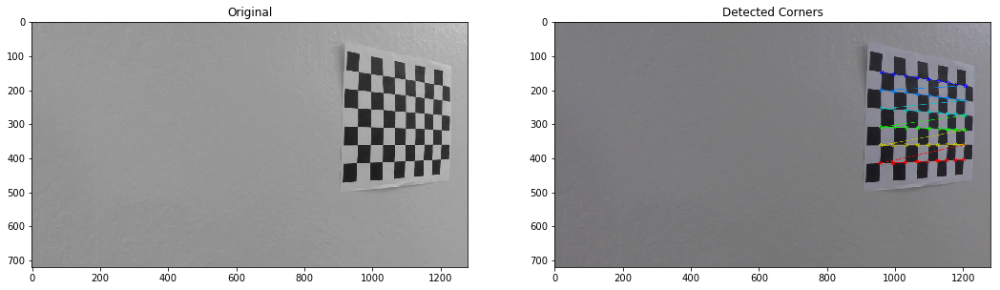

...

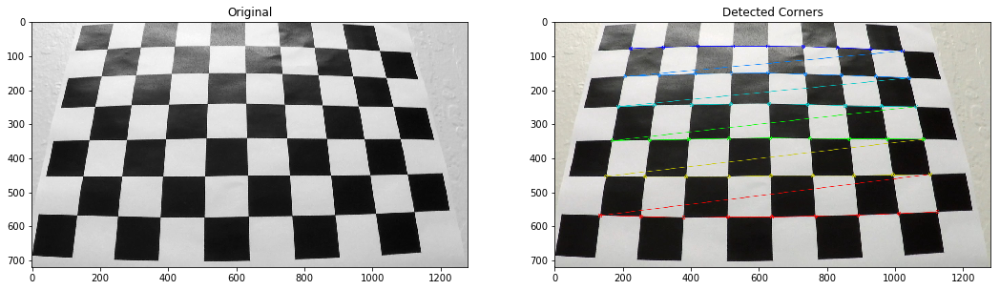

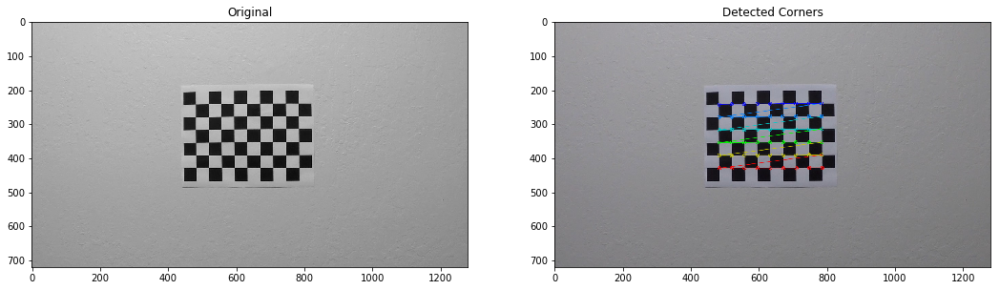

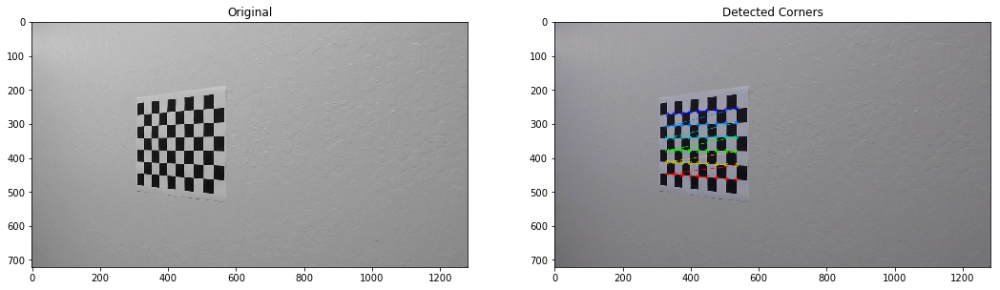

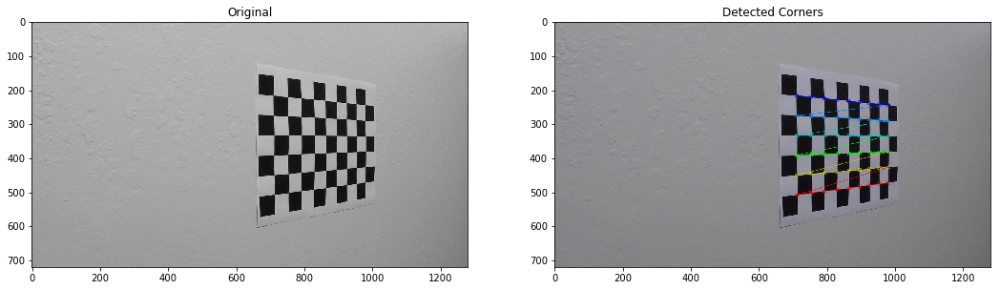

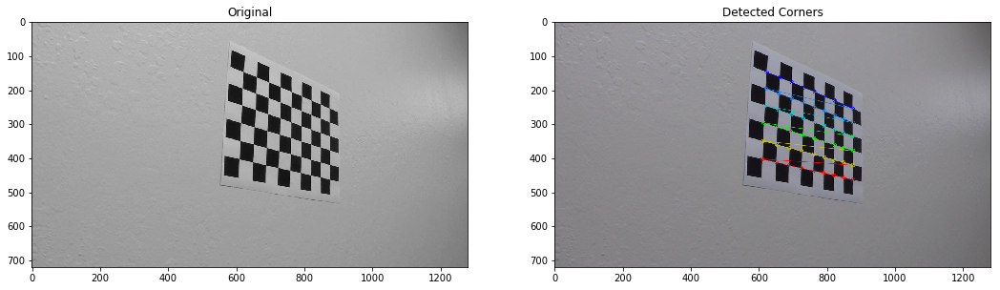

In [2]:
# Array to store object points and image points
objpoints = []
imgpoints = []

# Prepare the object points, (x,y,z), (0,0,0), (0,1,0)
objp = np.zeros((6*9,3), np.float32)

# Use np.mgrid function to generate cordinates
# Reshape the 3 cordinate shape into 2d of (x,y)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)

calibration_images = glob.glob('./camera_cal/calibration*.jpg')

for cal_image_file_path in calibration_images:
    cal_img = mpimg.imread(cal_image_file_path)
    cal_img_gray = cv2.cvtColor(cal_img, cv2.COLOR_RGB2GRAY)
    
    ret, corners = cv2.findChessboardCorners(cal_img_gray, (9,6), None)
    
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        
        #draw and display corners
        cv2.drawChessboardCorners(cal_img, (9,6), corners, ret)
        
        fig = plt.figure(figsize=(18,8))
        plt.subplot(121),plt.imshow(cal_img_gray, cmap='gray'),plt.title('Original')
        plt.subplot(122),plt.imshow(cal_img, cmap='gray'),plt.title('Detected Corners')

# these returned parameters from calibrateCamera() will be used later in other functions and routines
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, (cal_img_gray.shape[1], cal_img_gray.shape[0]), None, None)

### Undistort Images

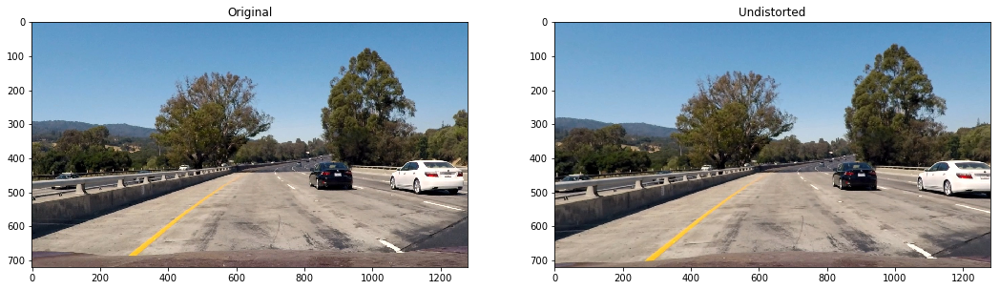

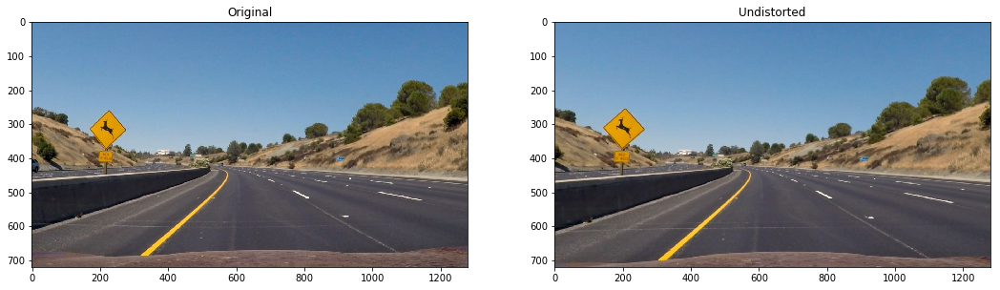

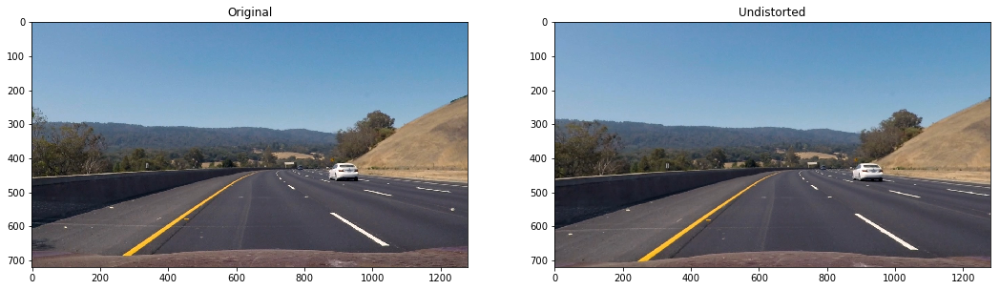

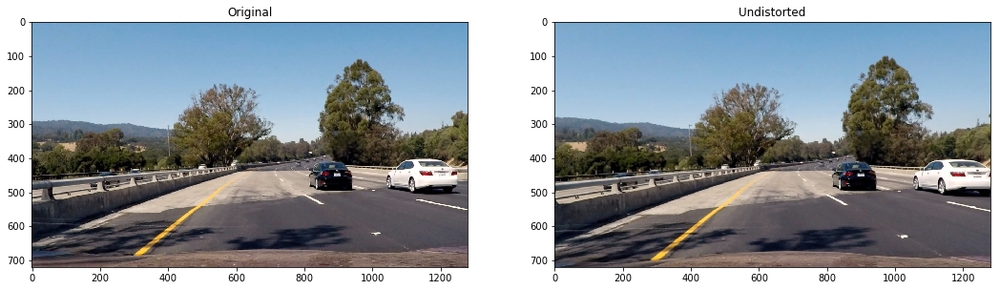

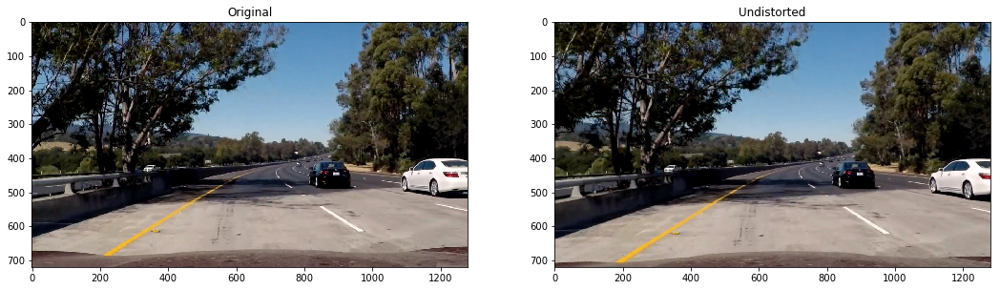

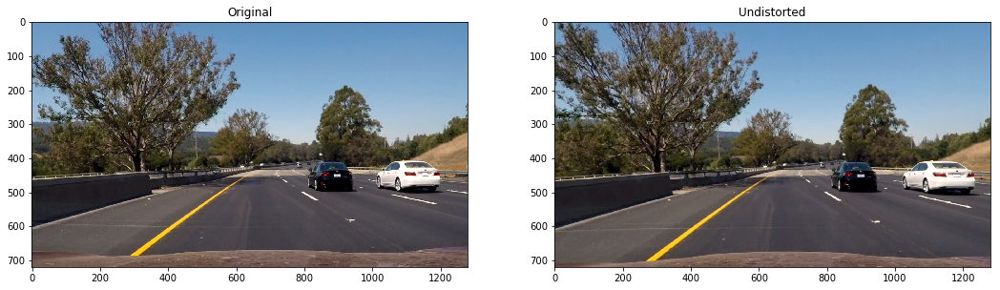

In [3]:
test_images = glob.glob('test_images/test*.jpg')

for image_path in test_images:
    img = mpimg.imread(image_path)
    dst = helper.undistort_image(img, mtx, dist)
    fig = plt.figure(figsize=(18,8))
    plt.subplot(121),plt.imshow(img),plt.title('Original')
    plt.subplot(122),plt.imshow(dst),plt.title('Undistorted')

### Warp Images

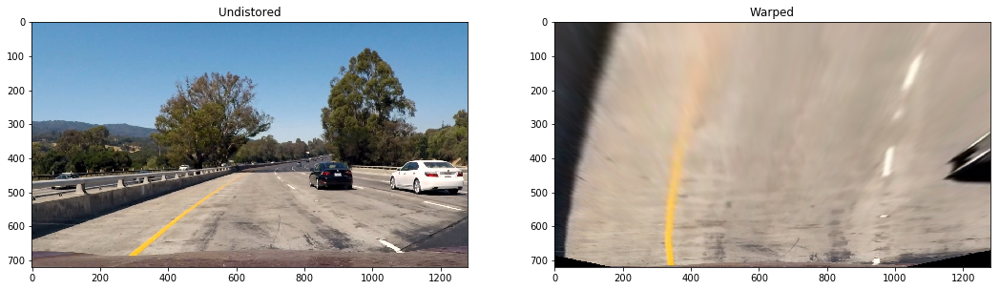

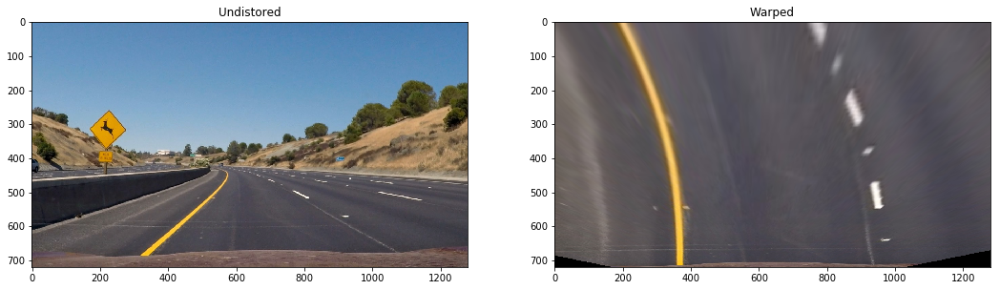

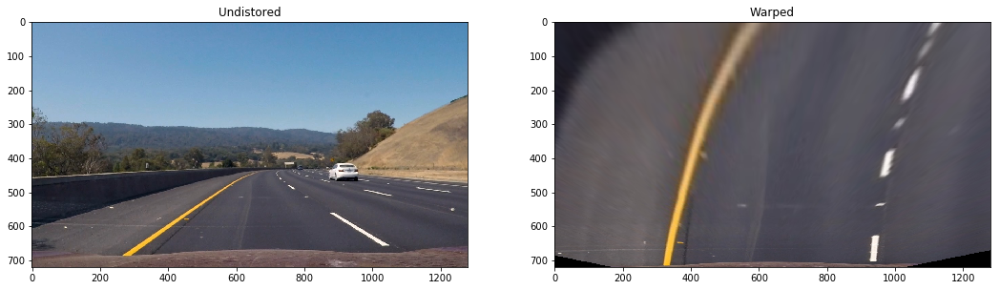

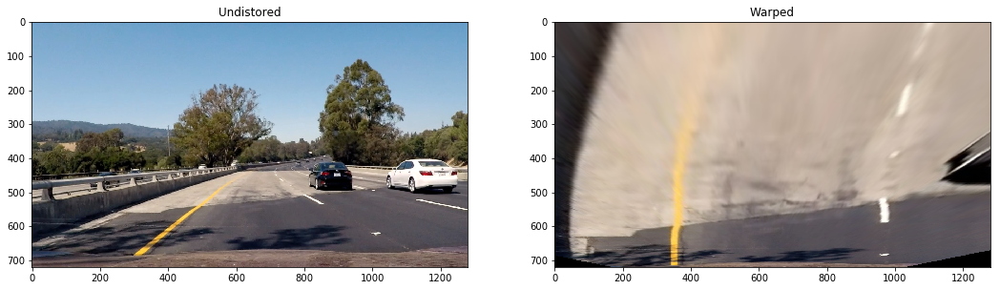

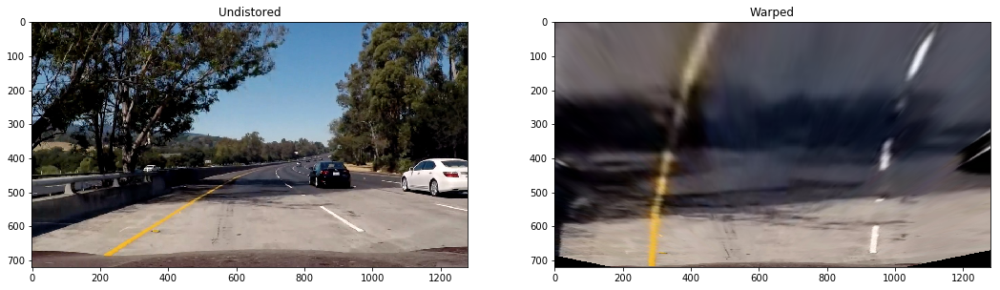

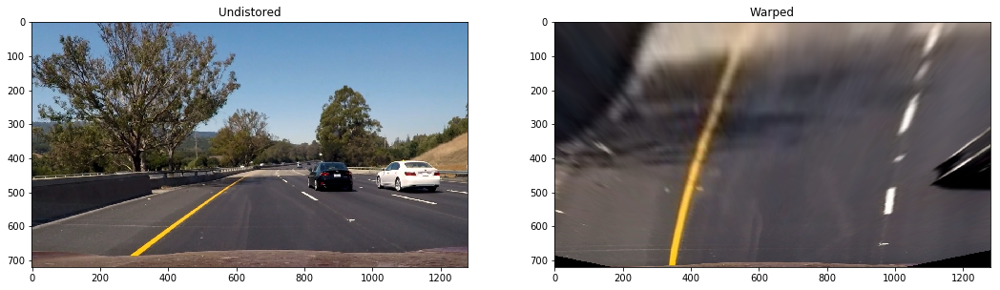

In [4]:
test_images = glob.glob('test_images/test*.jpg')

for image_path in test_images:
    img = mpimg.imread(image_path)
    undistored_img = helper.undistort_image(img, mtx, dist)
    warped_img, perspective_matrix, perspective_matrix_inverse = helper.warp_image(undistored_img)
    fig = plt.figure(figsize=(18,8))
    plt.subplot(121),plt.imshow(img),plt.title('Undistored')
    plt.subplot(122),plt.imshow(warped_img),plt.title('Warped')

### Apply S-Chanel & Gradient Thresholds

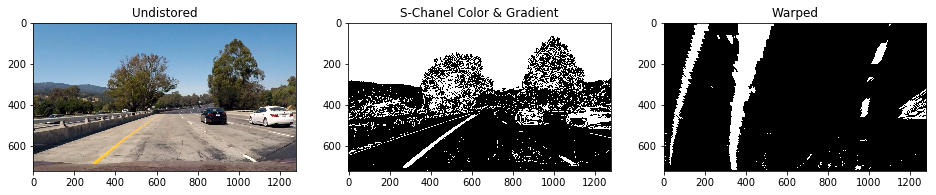

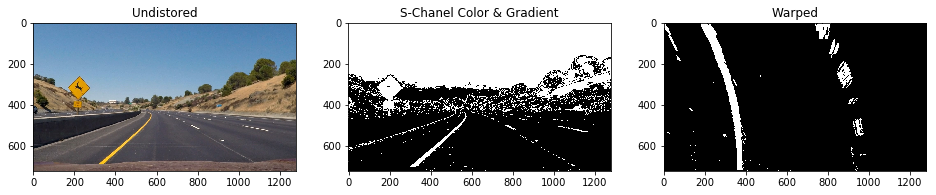

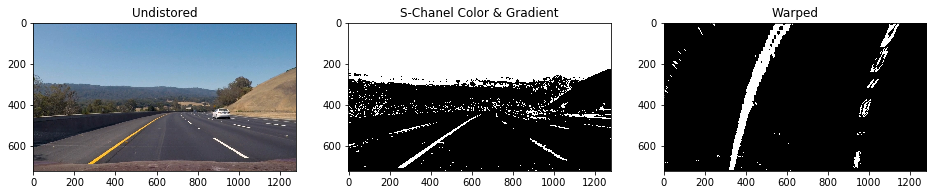

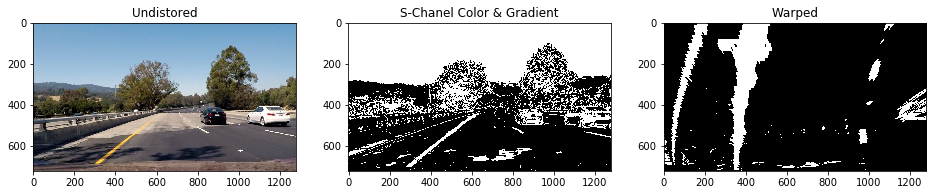

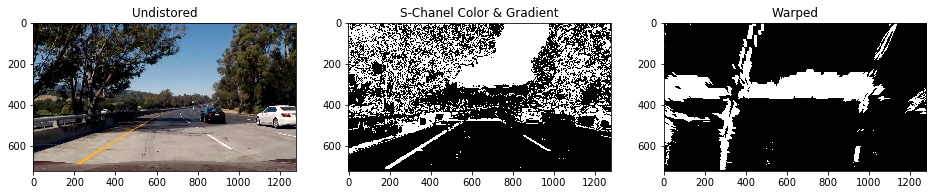

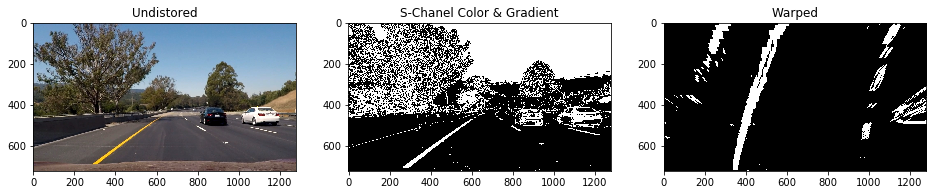

In [5]:
test_images = glob.glob('test_images/test*.jpg')

for image_path in test_images:
    img = mpimg.imread(image_path)
    undistored_img = helper.undistort_image(img, mtx, dist)
    thresholded_img = helper.apply_schanel_and_gradient(undistored_img)
    
    warped_img, perspective_matrix, perspective_matrix_inverse = helper.warp_image(thresholded_img)
    
    fig = plt.figure(figsize=(16,8))
    plt.subplot(131),plt.imshow(img),plt.title('Undistored')
    plt.subplot(132),plt.imshow(thresholded_img, cmap='gray'),plt.title('S-Chanel Color & Gradient')
    plt.subplot(133),plt.imshow(warped_img, cmap='gray'),plt.title('Warped')

### Detect Lanes

left_curv: 1987.92153987 right_curv: 671.203086629 center: 0.180888888889
is_parallel:  True


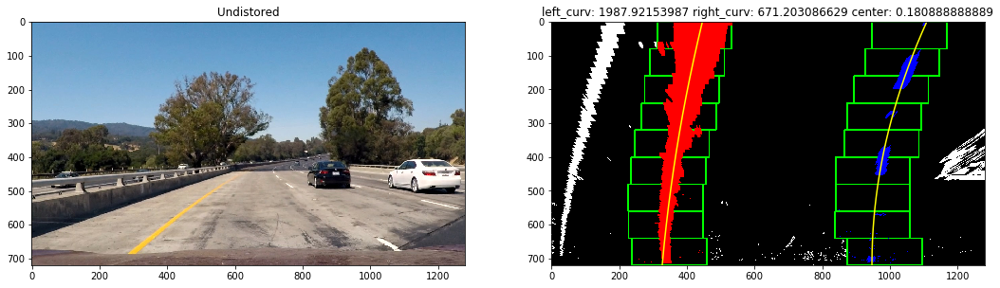

left_curv: 565.873034239 right_curv: 419.661936939 center: 0.115111111111
is_parallel:  True


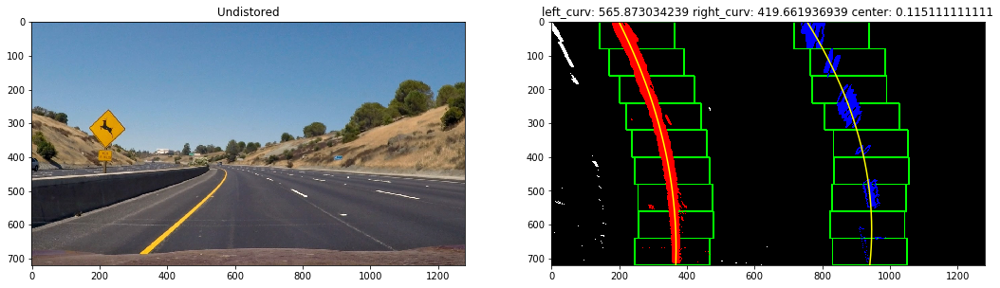

left_curv: 656.348403076 right_curv: 745.225367416 center: 0.312444444444
is_parallel:  True


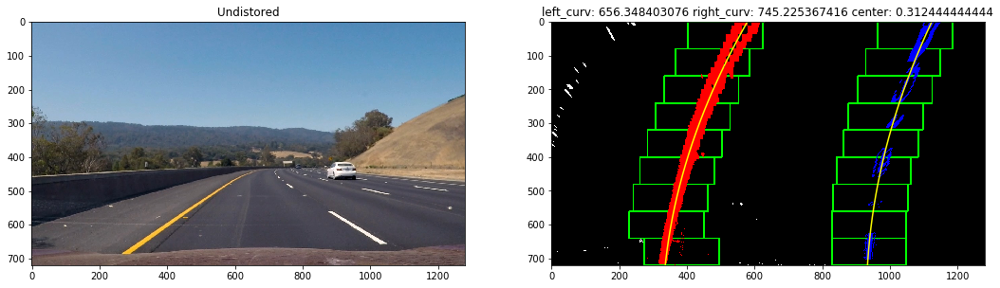

left_curv: 1966.3871264 right_curv: 694.561305793 center: 0.164444444444
is_parallel:  True


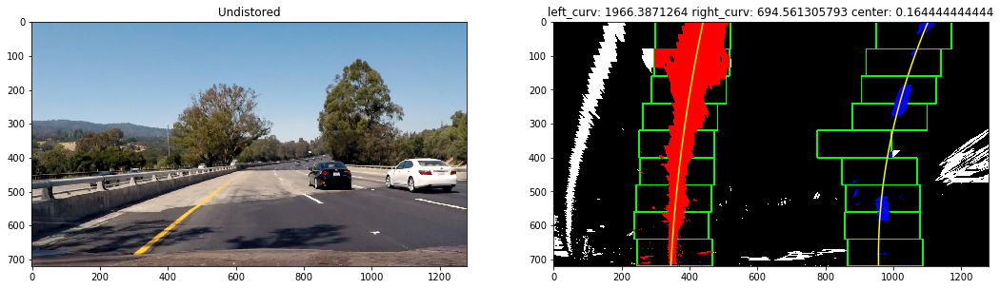

left_curv: 300.097581045 right_curv: 215.122030832 center: 0.0822222222222
is_parallel:  True


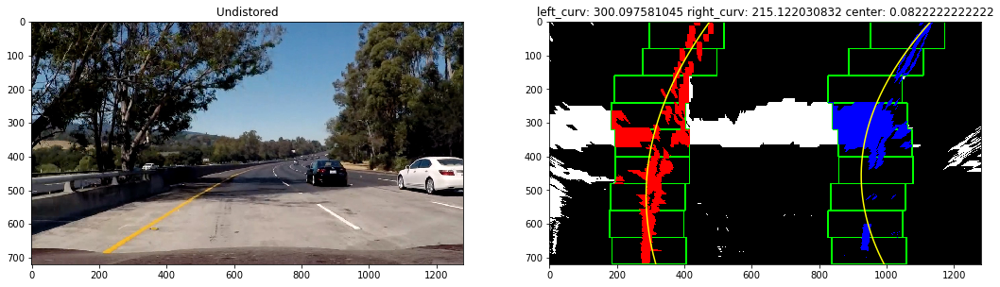

left_curv: 1318.63836971 right_curv: 1699.49340428 center: 0.444
is_parallel:  True


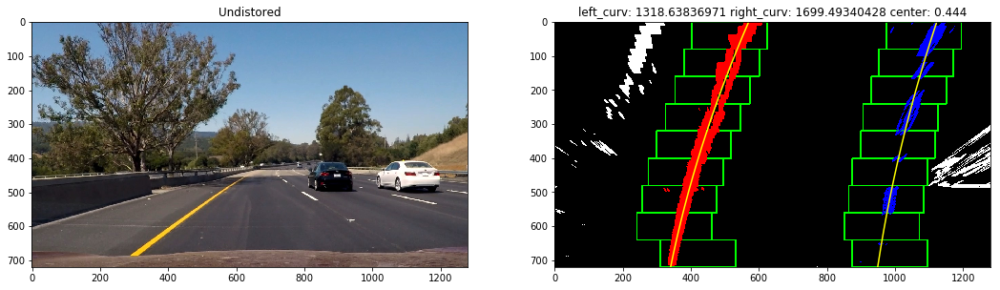

In [6]:
test_images = glob.glob('test_images/test*.jpg')

for image_path in test_images:
    img = mpimg.imread(image_path)
    undistored_img = helper.undistort_image(img, mtx, dist)
    thresholded_img = helper.apply_schanel_and_gradient(undistored_img)
    
    thresholded_warped, perspective_matrix, perspective_matrix_inverse = helper.warp_image(thresholded_img)
    
    left_fit, right_fit, left_lane_inds, right_lane_inds, rectangles = helper.find_lanes(thresholded_warped)
    
    sliding_windows_img = helper.visualize_sliding_windows(thresholded_warped, left_lane_inds, right_lane_inds, rectangles)
    
    ploty, plotx_left, plotx_right = helper.generate_polyfit_plot_data(thresholded_warped, left_fit, right_fit)
    
    curvature_info =  helper.calc_curvature_and_center(thresholded_warped, left_lane_inds, right_lane_inds)
    
    left_curv = curvature_info[0]
    right_curv = curvature_info[1]
    center = curvature_info[2]
    
    lane_detect_valid = helper.is_lane_detection_valid(left_curv,right_curv, 4.0, 4.0, left_fit, right_fit )
    
    #print('lane_detect_valid: ', lane_detect_valid)
    
    lane_detection_info = 'left_curv: ' + str(left_curv) +  ' right_curv: ' + str(right_curv) + ' center: ' + str(center)
    
    print(lane_detection_info)
    
    is_parallel = helper.check_lanes_parallel(plotx_left, plotx_right)
    #is_parallel = check_lanes_parallel_v2(plotx_left, plotx_right)
    print('is_parallel: ', is_parallel)

    fig = plt.figure(figsize=(18,8))
    plt.subplot(121),plt.imshow(img),plt.title('Undistored')
    plt.subplot(122),plt.imshow(sliding_windows_img,cmap='gray'),plt.title(lane_detection_info)
    
    plt.plot(plotx_left, ploty, color='yellow')
    plt.plot(plotx_right, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    plt.show()
    
    

### Detect Lanes on Challenge Video

left_curv: 2897.03241763 right_curv: 1230.10211541 center: 0.0945555555556
is_parallel:  False


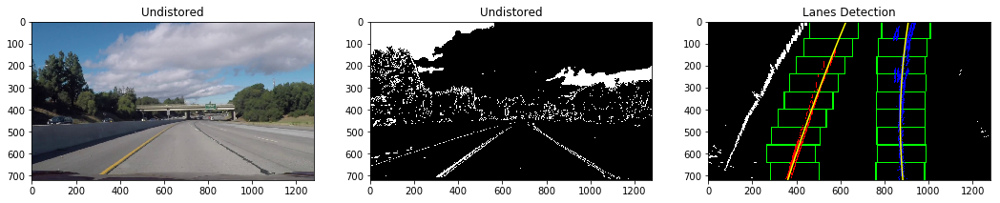

left_curv: 2197.99016075 right_curv: 1027.88646408 center: 0.00411111111111
is_parallel:  False


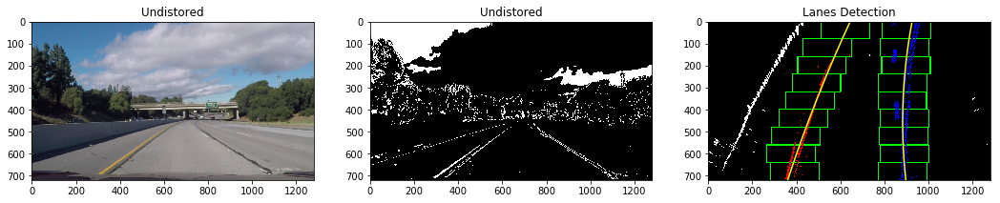

left_curv: 368.95606944 right_curv: 886.472516626 center: 0.213777777778
is_parallel:  False


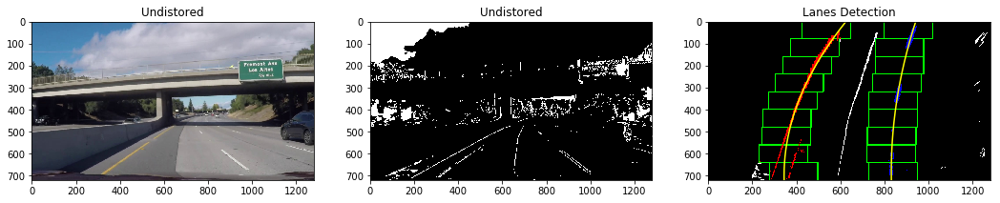

left_curv: 300.187296201 right_curv: 1479.23548993 center: 0.518
is_parallel:  True


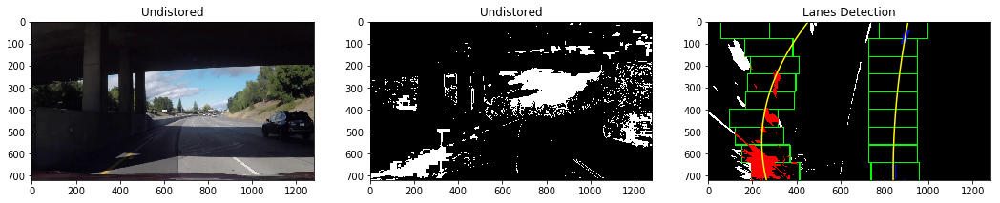

left_curv: 499.468940792 right_curv: 899.280776967 center: 0.213777777778
is_parallel:  False


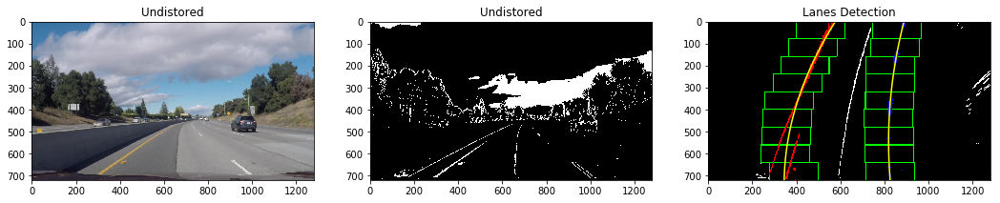

left_curv: 756.42628659 right_curv: 422.938139275 center: 0.131555555556
is_parallel:  False


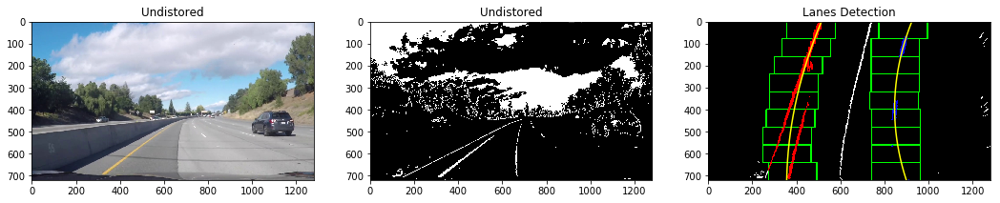

In [7]:
test_images = glob.glob('test_images/challenge*.jpg')

for image_path in test_images:
    img = mpimg.imread(image_path)
    
    undistored_img = helper.undistort_image(img, mtx, dist)
    
    thresholded_img = helper.apply_schanel_and_gradient(undistored_img)
    
    #thresholded_warped, perspective_matrix, perspective_matrix_inverse = helper.warp_image(thresholded_img)
    thresholded_warped, perspective_matrix, perspective_matrix_inverse = helper.warp_image2(thresholded_img)

    left_fit, right_fit, left_lane_inds, right_lane_inds, rectangles = helper.find_lanes(thresholded_warped)
    
    sliding_windows_img = helper.visualize_sliding_windows(thresholded_warped, left_lane_inds, right_lane_inds, rectangles)
    
    ploty, plotx_left, plotx_right = helper.generate_polyfit_plot_data(thresholded_warped, left_fit, right_fit)
    
    curvature_info =  helper.calc_curvature_and_center(thresholded_warped, left_lane_inds, right_lane_inds)
    
    left_curv = curvature_info[0]
    right_curv = curvature_info[1]
    center = curvature_info[2]
    
    lane_detect_valid = helper.is_lane_detection_valid(left_curv,right_curv, 4.0, 4.0, left_fit, right_fit )

    lane_detection_info = 'left_curv: ' + str(left_curv) +  ' right_curv: ' + str(right_curv) + ' center: ' + str(center)
    
    print(lane_detection_info)
    
    is_parallel = helper.check_lanes_parallel(plotx_left, plotx_right,lane_width_min = 450, lane_width_max = 700)
    
    print('is_parallel: ', is_parallel)
    
    
    fig = plt.figure(figsize=(18,8))
    plt.subplot(131),plt.imshow(img),plt.title('Undistored')
    plt.subplot(132),plt.imshow(thresholded_img,cmap='gray'),plt.title('Undistored')
    plt.subplot(133),plt.imshow(sliding_windows_img,cmap='gray'),plt.title('Lanes Detection')
    
    plt.plot(plotx_left, ploty, color='yellow')
    plt.plot(plotx_right, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    plt.show()

### Paint Detected Region

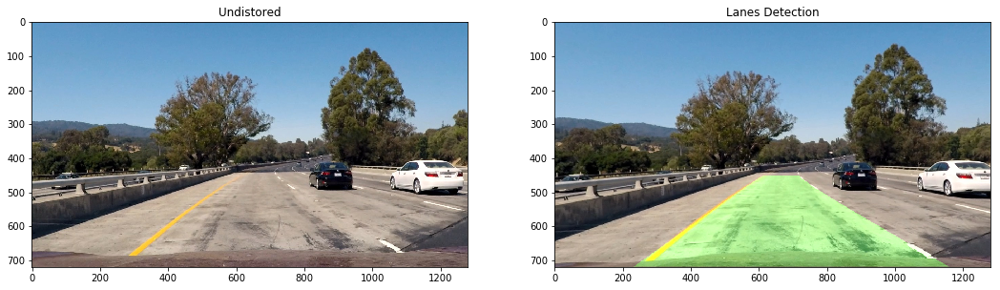

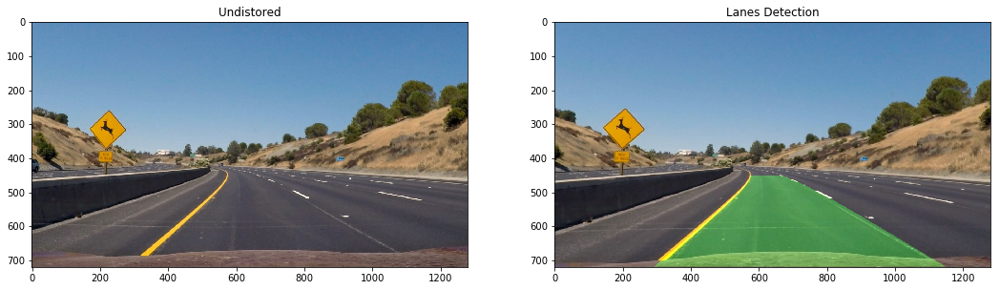

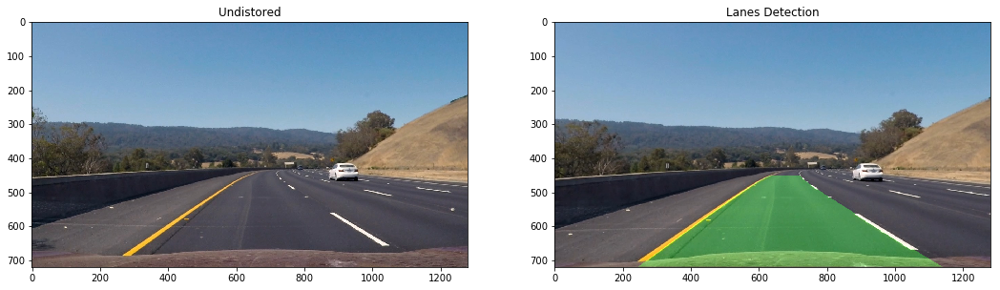

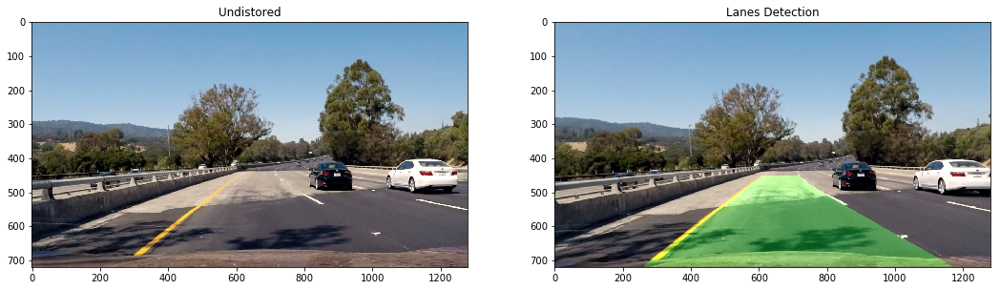

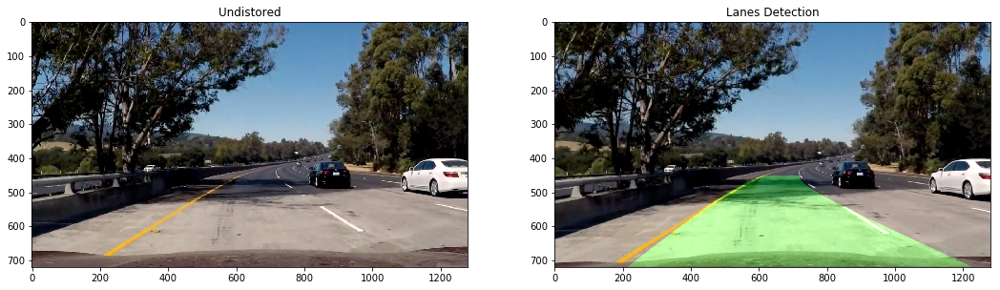

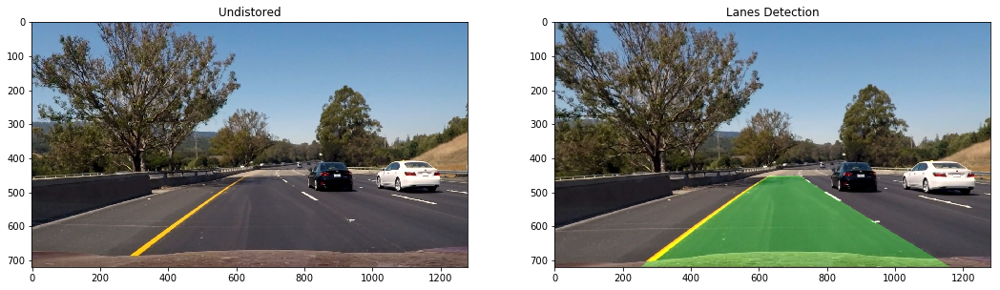

In [8]:
test_images = glob.glob('test_images/test*.jpg')

for image_path in test_images:
    img = mpimg.imread(image_path)
    undistored_img = helper.undistort_image(img, mtx, dist)
    thresholded_img = helper.apply_schanel_and_gradient(undistored_img)
    
    thresholded_warped, perspective_matrix, perspective_matrix_inverse = helper.warp_image(thresholded_img)
    
    left_fit, right_fit, left_lane_inds, right_lane_inds, rectangles = helper.find_lanes(thresholded_warped)
    
    painted_region_img = helper.paint_lanes_interest_region(undistored_img,thresholded_warped,left_fit, right_fit, perspective_matrix_inverse )
    
    fig = plt.figure(figsize=(18,8))
    plt.subplot(121),plt.imshow(img),plt.title('Undistored')
    plt.subplot(122),plt.imshow(painted_region_img),plt.title('Lanes Detection')

### Pain Detected Region on Challenge Video

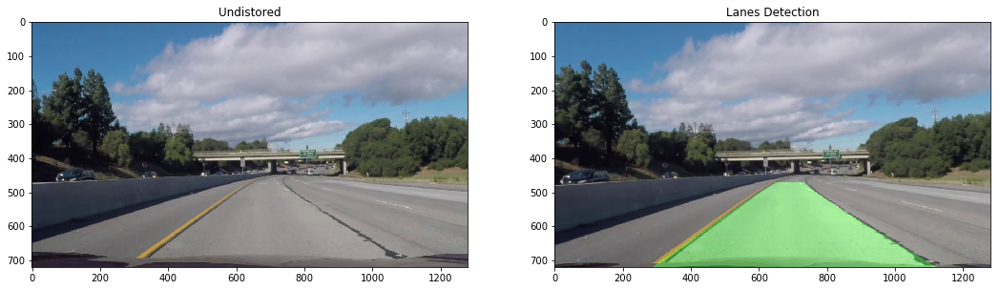

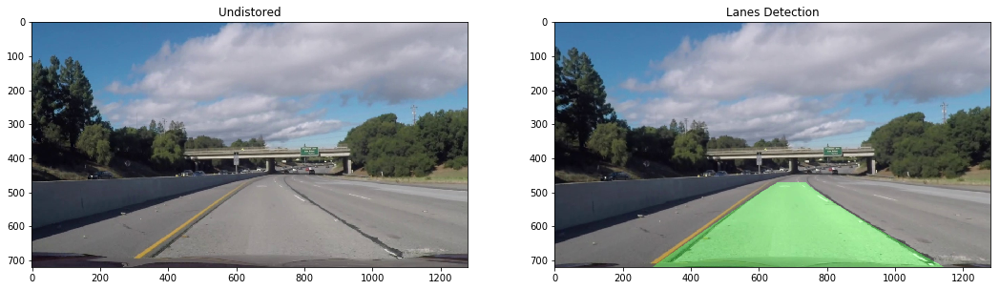

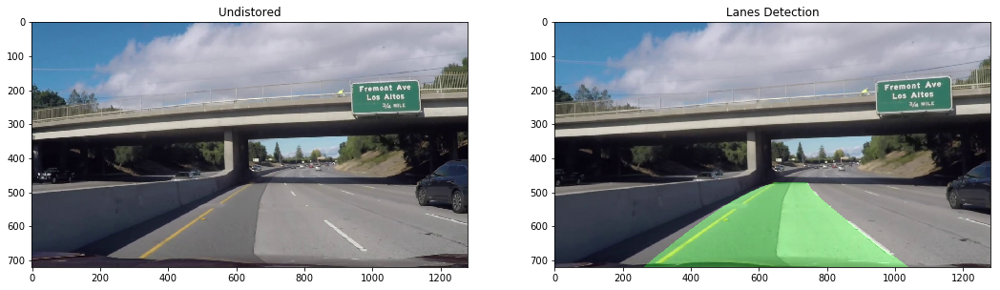

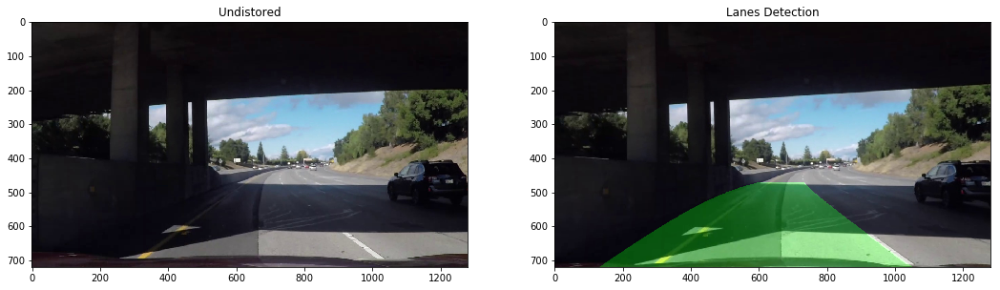

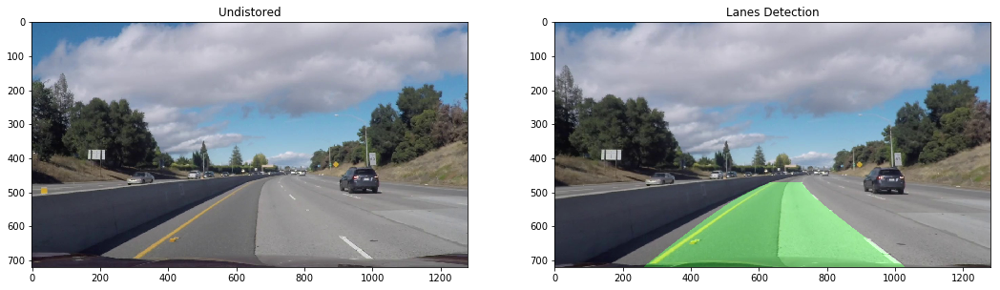

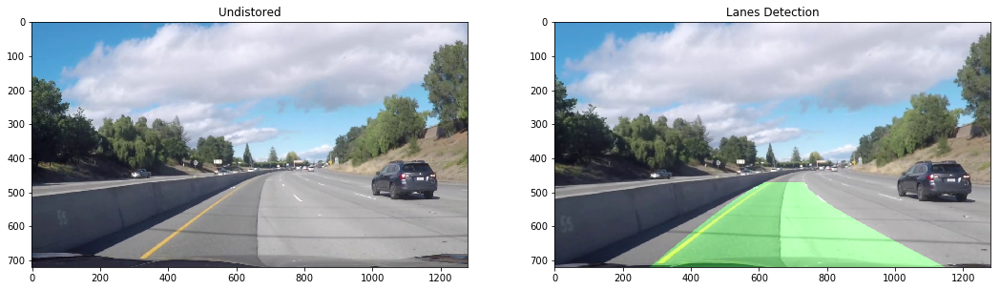

In [9]:
test_images = glob.glob('test_images/challenge*.jpg')

for image_path in test_images:
    img = mpimg.imread(image_path)
    undistored_img = helper.undistort_image(img, mtx, dist)
    thresholded_img = helper.apply_schanel_and_gradient(undistored_img)
    
    thresholded_warped, perspective_matrix, perspective_matrix_inverse = helper.warp_image2(thresholded_img)
    
    left_fit, right_fit, left_lane_inds, right_lane_inds, rectangles = helper.find_lanes(thresholded_warped)
    
    painted_region_img = helper.paint_lanes_interest_region(undistored_img,thresholded_warped,left_fit, right_fit, perspective_matrix_inverse )
    
    fig = plt.figure(figsize=(18,8))
    plt.subplot(121),plt.imshow(img),plt.title('Undistored')
    plt.subplot(122),plt.imshow(painted_region_img),plt.title('Lanes Detection')

### Lanes Detection Pipeline

In [11]:
is_lane_fit_data_found = False
left_fit, right_fit, left_lane_inds, right_lane_inds = None, None,None,None

curvature_info = None
curvature_info_counter = 0

left_line_info = lineinfo.LineInfo()
right_line_info = lineinfo.LineInfo()

process_video_image_count = 0

source_video_file_path = ''

def process_video_image(the_image):
    
    global is_lane_fit_data_found
    global left_fit, right_fit, ploty,leftx, rightx, left_fitx, right_fitx
    global curvature_info
    global curvature_info_counter
    global process_video_image_count
    global source_video_file_path;
    
    curvature_info_counter += 1
    process_video_image_count += 1

    undistorted_image = helper.undistort_image(the_image, mtx, dist)
    
    thresholded_image = helper.apply_schanel_and_gradient(undistorted_image)

    if source_video_file_path == './challenge_video.mp4':
        
        thresholded_warped_image, perspective_M, Minv = helper.warp_image2(thresholded_image)
    else:
        thresholded_warped_image, perspective_M, Minv = helper.warp_image(thresholded_image)   

    if is_lane_fit_data_found == False:
        
        is_lane_fit_data_found = True
        left_fit, right_fit, left_lane_inds, right_lane_inds, rectangles = helper.find_lanes(thresholded_warped_image)

    else:
        left_fit, right_fit, left_lane_inds, right_lane_inds = helper.find_lanes_with_known_fits(thresholded_warped_image, left_fit, right_fit)
    

    ploty, plotx_left, plotx_right = helper.generate_polyfit_plot_data(thresholded_warped_image, left_fit, right_fit)
    
    is_lanes_parallel = helper.check_lanes_parallel(plotx_left, plotx_right)
    
    if is_lanes_parallel == True:
        is_lane_fit_data_found = True
        
        left_line_info.detected = True;
        right_line_info.detected = True;
    else:
        is_lane_fit_data_found = False
    
    # calc curvature for every 5 frames
    if curvature_info_counter == 5 or curvature_info is None:
        curvature_info =  helper.calc_curvature_and_center(thresholded_warped_image, left_lane_inds, right_lane_inds)
        curvature_info_counter = 0
    
    final_image = helper.paint_lanes_interest_region(undistorted_image,thresholded_warped_image,left_fit, right_fit, Minv )

    final_image = helper.write_curvature_info_on_image(final_image, curvature_info)
    
    return final_image

### Apply Lanes Dectection on Video

In [12]:
videos_output_dir = 'videos_output'
if not os.path.isdir(videos_output_dir):
    os.makedirs(videos_output_dir)

video_output = videos_output_dir + '/project_video.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("./project_video.mp4")

#output_clip = clip1.fl_image(visualize_street_lines_on_image) #NOTE: this function expects color images!!
output_clip = clip1.fl_image(process_video_image)
%time output_clip.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video videos_output/project_video.mp4
[MoviePy] Writing video videos_output/project_video.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [02:57<00:00,  6.93it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: videos_output/project_video.mp4 

Wall time: 2min 58s


In [5]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))

In [9]:
videos_output_dir = 'videos_output'
video_output2 = videos_output_dir + '/challenge_video.mp4'
source_video_file_path = './challenge_video.mp4'
clip2 = VideoFileClip(source_video_file_path)

output_clip2 = clip2.fl_image(process_video_image) 
%time output_clip2.write_videofile(video_output2, audio=False)

[MoviePy] >>>> Building video videos_output/challenge_video.mp4
[MoviePy] Writing video videos_output/challenge_video.mp4


100%|████████████████████████████████████████████████████████████████████████████████| 485/485 [01:04<00:00,  7.79it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: videos_output/challenge_video.mp4 

Wall time: 1min 5s


In [10]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output2))

### Live Video Processing

In [3]:
cap = cv2.VideoCapture('./challenge_video.mp4')

while(cap.isOpened()):
    ret, frame = cap.read()

    #gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    processed_frame = process_video_image(frame)

    #cv2.imshow('frame',gray)
    cv2.imshow('frame',processed_frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()

NameError: name 'process_video_image' is not defined